In [19]:
import spotiphy
import numpy as np
import pandas as pd
import matplotlib as mpl
import scanpy as sc
import squidpy as sq
import importlib as imp
import matplotlib.pyplot as plt
import anndata as ad
imp.reload(spotiphy)
imp.reload(spotiphy.deconvolution)
imp.reload(spotiphy.sc_reference)

<module 'spotiphy.sc_reference' from 'C:\\Users\\zzheng92\\Desktop\\Spotiphy\\spotiphy\\sc_reference.py'>

In [2]:
%%time
adata_sc_files = ["F:/Ziqian Zheng/Spatial omics/Public dataset/scRNA/scRNA.h5ad",
            "F:/Ziqian Zheng/Spotiphy_data/SCRNA/sum_43plus_anno.h5ad",]
adata_sc = sc.read_h5ad(adata_sc_files[1])
adata_st = sc.read_visium("F:/Ziqian Zheng/Spotiphy_data/ST/Sample221/outs")
adata_st.var_names_make_unique()
results_folder = 'results/221_43plus/'
key_type = 'majortype'
type_list = sorted(list(adata_sc.obs[key_type].unique()))

anndata.py (1832): Variable names are not unique. To make them unique, call `.var_names_make_unique`.


CPU times: total: 1min 39s
Wall time: 2min 7s


In [4]:
%%time
adata_sc, adata_st = spotiphy.initialization(adata_sc, adata_st)

CPU times: total: 1min 4s
Wall time: 1min 4s


In [5]:
%%time
sc_ref = spotiphy.construct_sc_ref(adata_sc, key_type=key_type)

CPU times: total: 3min 46s
Wall time: 3min 46s


100%|██████████| 12000/12000 [17:51<00:00, 11.20it/s]


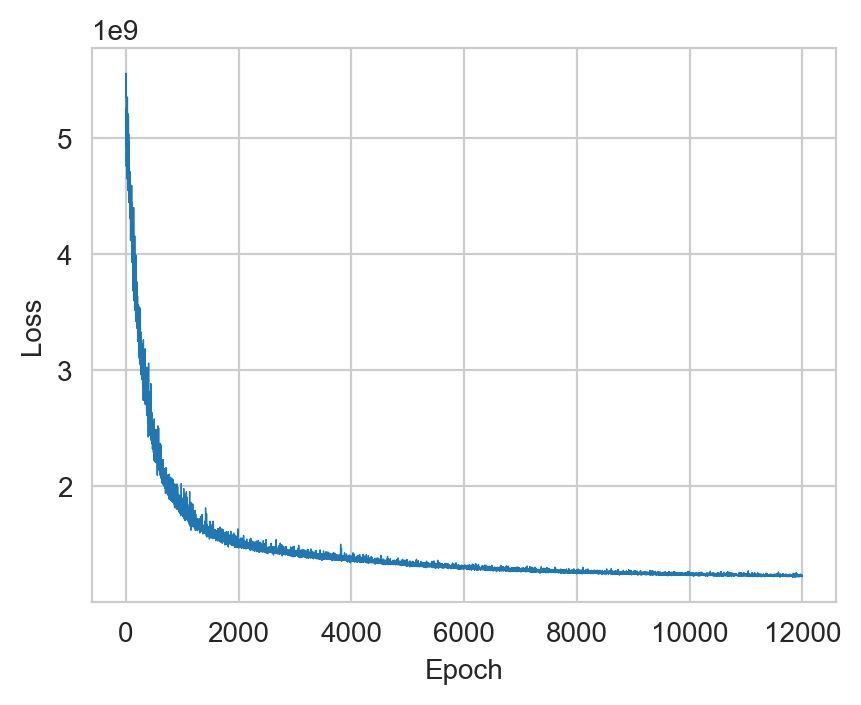

<timed exec> (5): Trying to modify attribute `.obs` of view, initializing view as actual.


CPU times: total: 17min 48s
Wall time: 17min 56s


In [6]:
%%time
X = np.array(adata_st.X)
pyro_params = spotiphy.deconvolution.deconvolute(X, sc_ref, n_epoch=12000, plot=True)
sigma = pyro_params['sigma'].cpu().detach().numpy()
cell_proportion = sigma/np.sum(sigma, axis=1)[:, np.newaxis]
adata_st.obs[type_list] = cell_proportion
np.save(results_folder+'proportion_full.npy', cell_proportion)

In [7]:
with mpl.rc_context({'figure.figsize': [4, 4.5], 'figure.dpi': 600}):
    ax = sc.pl.spatial(adata_st, cmap='magma', color=type_list, img_key='hires', vmin=0, vmax='p98', ncols=5, size=1.3, show=False)
    ax[0].get_figure().savefig(results_folder+'spotiphy_full.jpg')

In [16]:
alpha = pyro_params['pi'].cpu().detach().numpy()
X = adata_st.X
X = X/alpha
adata_st.X = X

In [20]:
%%time
adata_st_decomposed = spotiphy.deconvolution.decomposition(adata_st, adata_sc, key_type, cell_proportion, save=True,
                               out_dir=results_folder, threshold=0.1, spot_location=adata_st.obsm['spatial'], filtering_gene=False,
                               filename='ST_decomposition_full.h5ad')

CPU times: total: 5min 19s
Wall time: 5min 19s


In [21]:
n_decompose = len(adata_st_decomposed)
n_sc = len(adata_sc)
adata_merge = ad.concat([adata_sc, adata_sc[:n_decompose]])
adata_merge.obs_names = list(adata_sc.obs_names) + [str(i) for i in range(n_decompose)]

anndata.py (1830): Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


In [22]:
adata_merge.obs.iloc[n_sc:] = 0
adata_merge.obs.iloc[n_sc:, adata_merge.obs.columns.get_loc('orig.ident')] = 'spatial'
adata_merge.obs.iloc[n_sc:, adata_merge.obs.columns.get_loc('majortype')] = adata_st_decomposed.obs['cell_type']
adata_merge.obs.iloc[n_sc:, adata_merge.obs.columns.get_loc('decon')] = adata_st_decomposed.obs['cell_type']
adata_merge.obs.iloc[n_sc:, adata_merge.obs.columns.get_loc('doublet_finder')] = '0'
adata_merge.obs.iloc[n_sc:, adata_merge.obs.columns.get_loc('CellName')] = '0'

In [24]:
X1 = adata_sc.X.toarray()
X2 = adata_st_decomposed.X
X = np.vstack((X1, X2))
del X1, X2
adata_merge.X = X
del X
adata_merge.write(results_folder+'adata_merge_full.h5ad')

anndata.py (1222): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1222): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1222): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1222): Trying to modify attribute `.obs` of view, initializing view as actual.
anndata.py (1222): Trying to modify attribute `.obs` of view, initializing view as actual.


In [25]:
sc.pp.normalize_total(adata_merge, target_sum=1e6)
sc.pp.log1p(adata_merge)
adata_merge.raw = adata_merge

scatterplots.py (392): No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


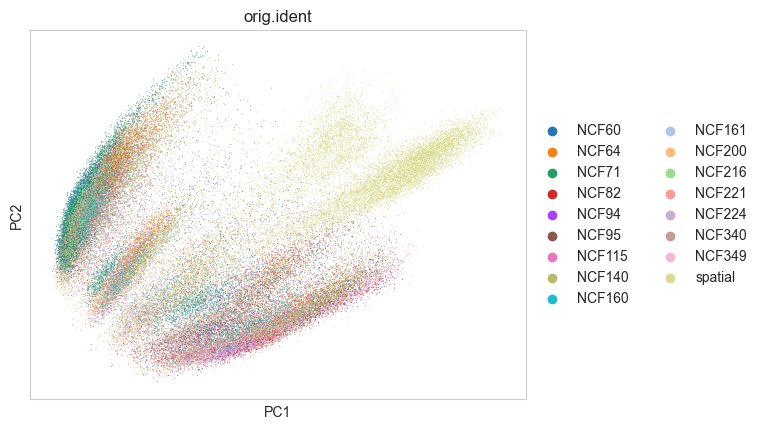

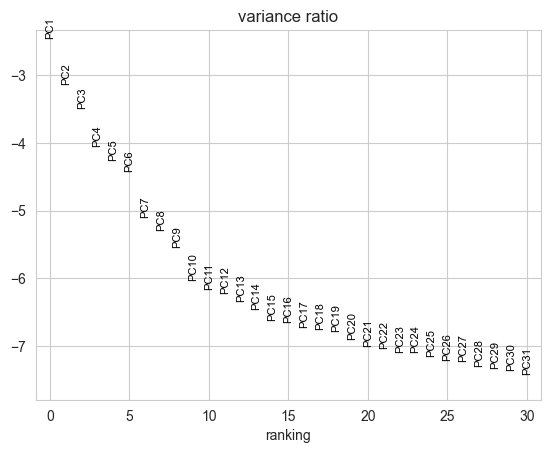

In [26]:
sc.tl.pca(adata_merge, svd_solver='arpack')
sc.pl.pca(adata_merge, color='orig.ident')
sc.pl.pca_variance_ratio(adata_merge, log=True)

scatterplots.py (392): No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


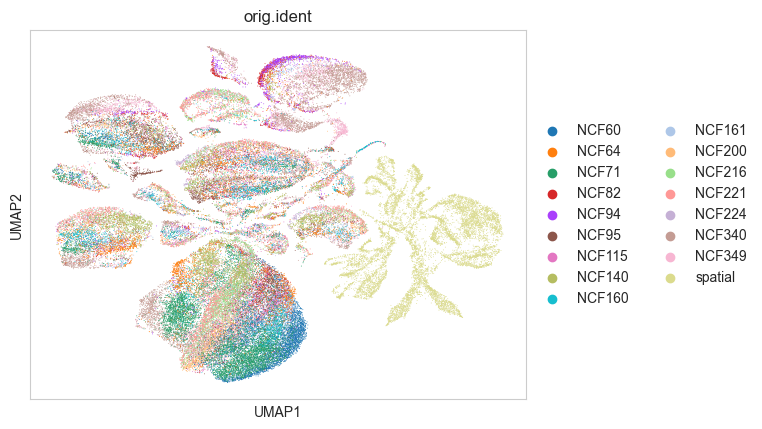

In [27]:
sc.pp.neighbors(adata_merge, n_neighbors=10, n_pcs=40)
sc.tl.umap(adata_merge)
sc.pl.umap(adata_merge, color='orig.ident')